In [2]:
import pandas as pd

amazon_data = pd.read_csv('./Reviews.csv.zip')
amazon_data.head()


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [3]:
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px

fig = px.histogram(amazon_data, x="Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

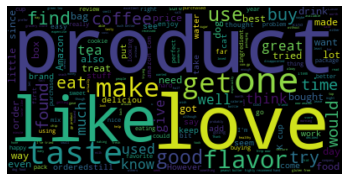

In [4]:
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud 

###create stopword list
stopwords = set(stopwords.words('english'))
stopwords.update(["br", "href"])
text = " ".join(review for review in amazon_data.Text)
wordcloud = WordCloud(stopwords=stopwords).generate(text)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud11.png')
plt.show()

In [5]:
amazon_data = amazon_data[amazon_data['Score'] != 3]
amazon_data['Sentiment'] = amazon_data['Score'].apply(lambda rating : +1 if rating > 3 else -1)
amazon_data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1


In [6]:
# split amazon_data - positive and negative sentiment:

positive = amazon_data[amazon_data['Sentiment'] == 1]
negative = amazon_data[amazon_data['Sentiment'] == -1]

# wordcloud -- positive Sentiment

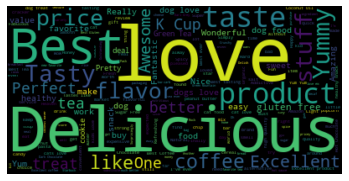

In [7]:
stopwords.update(["br", "href","good","great"])

pos = " ".join(review for review in positive.Summary)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)

plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud22.png')
plt.show()

# wordcloud -- negative Sentiment

In [8]:
neg = " ".join(review for review in negative.Summary)
wordcloud3 = WordCloud(stopwords=stopwords).generate(neg)
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud33.png')
plt.show()

TypeError: sequence item 5030: expected str instance, float found

In [9]:
amazon_data['Sentiment'] = amazon_data['Sentiment'].replace({-1 : 'negative'})
amazon_data['Sentiment'] = amazon_data['Sentiment'].replace({1 : 'positive'})
fig = px.histogram(amazon_data, x="Sentiment")
fig.update_traces(marker_color="indianred", marker_line_color = 'rgb(8,48,107)', marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
fig.show()

# Data cleaning

In [1]:
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":", "!", '"'))
    return final

amazon_data['Text'] = amazon_data['Text'].apply(remove_punctuation)
amazon_data = amazon_data.dropna(subset=['Summary'])
amazon_data['Summary'] = amazon_data['Summary'].apply(remove_punctuation)

NameError: name 'amazon_data' is not defined

# Split the Dataframe

In [11]:
amazon_data_new = amazon_data[['Summary', 'Sentiment']]
amazon_data_new.head()

,Summary,Sentiment
0,Good Quality Dog Food,positive
1,Not as Advertised,negative
2,"""Delight"" says it all",positive
3,Cough Medicine,negative
4,Great taffy,positive


In [12]:
# random split train(80%) and test(20%) data
import numpy as np
index = amazon_data.index
amazon_data['random_number'] = np.random.randn(len(index))

train = amazon_data[amazon_data['random_number'] <= 0.8]
test = amazon_data[amazon_data['random_number'] > 0.8]

In [18]:
# count vectorizer

from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')

train_matrix = vectorizer.fit_transform(train['Summary'].values.astype(str))
test_matrix = vectorizer.transform(test['Summary'].values.astype(str))

In [19]:
# Logistic regression

from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()

In [20]:
X_train = train_matrix
X_test = test_matrix
Y_train = train['Sentiment']
Y_test = test['Sentiment']

In [21]:
lr.fit(X_train, Y_train)

C:\Users\LENOVO\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [22]:
predictions = lr.predict(X_test)

In [23]:
# find accuracy, precision, recall:

from sklearn.metrics import confusion_matrix, classification_report

new = np.asarray(Y_test)
confusion_matrix(predictions, Y_test)

array([[11502,  2370],
       [ 5899, 91558]], dtype=int64)

In [24]:
print(classification_report(predictions,Y_test))

              precision    recall  f1-score   support

    negative       0.66      0.83      0.74     13872
    positive       0.97      0.94      0.96     97457

    accuracy                           0.93    111329
   macro avg       0.82      0.88      0.85    111329
weighted avg       0.94      0.93      0.93    111329

